Generating Milky Way model with prominent spiral arms...
Creating visualization...


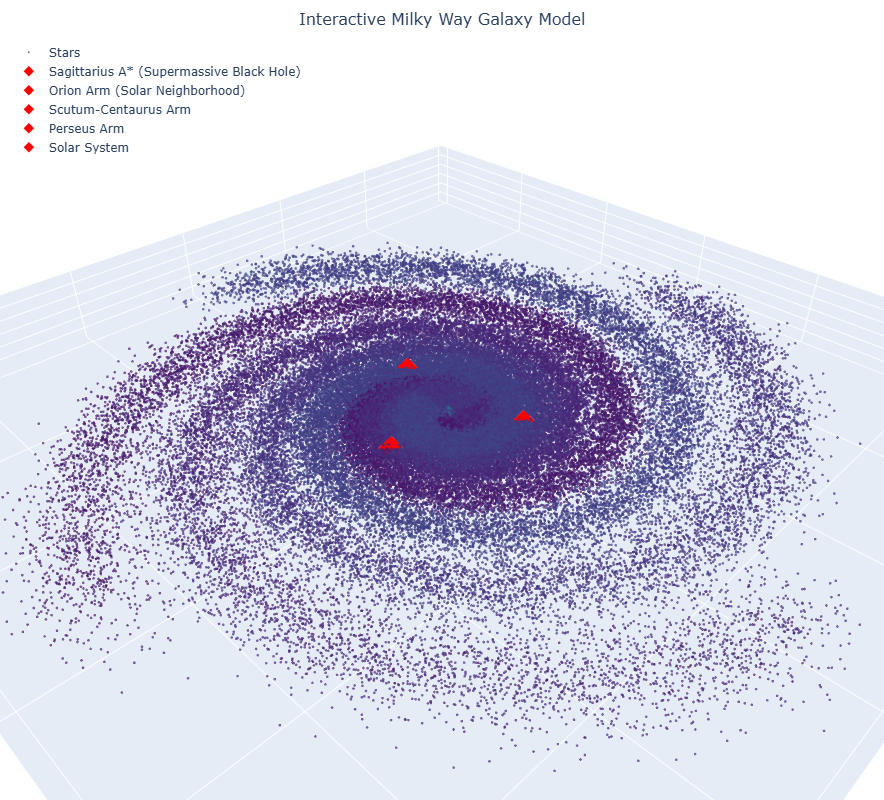

In [6]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from matplotlib.animation import PillowWriter
from plotly.subplots import make_subplots

def generate_galaxy(n_stars=50000):
    """Generate a simplified model of the Milky Way galaxy with prominent spiral arms"""
    # Parameters for the galaxy
    galaxy_radius = 50000  # light-years
    disk_height = 1000     # light-years
    bulge_radius = 5000    # light-years
    
    # Create empty dataframe
    galaxy_df = pd.DataFrame()
    
    # Generate bulge stars (spherical distribution)
    n_bulge = int(0.1 * n_stars)  # Reduced bulge percentage to emphasize arms
    bulge_r = np.random.exponential(scale=bulge_radius/3, size=n_bulge)
    bulge_theta = np.random.uniform(0, 2*np.pi, n_bulge)
    bulge_phi = np.random.uniform(0, np.pi, n_bulge)
    
    bulge_x = bulge_r * np.sin(bulge_phi) * np.cos(bulge_theta)
    bulge_y = bulge_r * np.sin(bulge_phi) * np.sin(bulge_theta)
    bulge_z = bulge_r * np.cos(bulge_phi)
    
    bulge_brightness = np.random.exponential(scale=0.5, size=n_bulge) + 0.5
    bulge_region = ['Galactic Bulge'] * n_bulge
    
    # Generate disk stars with more pronounced spiral arms
    n_disk = n_stars - n_bulge
    
    # Parameters for spiral arms
    n_arms = 4
    arm_width = 2500  # Narrower arms (light-years)
    winding = 0.5     # Increased winding parameter
    
    # Initialize arrays
    disk_x = np.zeros(n_disk)
    disk_y = np.zeros(n_disk)
    disk_z = np.zeros(n_disk)
    disk_region = [''] * n_disk
    disk_brightness = np.zeros(n_disk)
    
    # Regions for the arms
    arm_names = ['Perseus Arm', 'Scutum-Centaurus Arm', 'Sagittarius Arm', 'Outer Arm']
    arm_colors = [0.3, 0.5, 0.7, 0.9]  # Different brightness for each arm
    
    # Generate each arm
    stars_per_arm = n_disk // n_arms
    for i in range(n_arms):
        start_idx = i * stars_per_arm
        end_idx = (i+1) * stars_per_arm if i < n_arms-1 else n_disk
        
        # Logarithmic spiral parameters
        a = 10000  # Scale factor
        b = 0.2    # Tightness factor
        
        # Generate points along a logarithmic spiral
        t = np.linspace(0, 4*np.pi, end_idx-start_idx)  # Longer arms
        r = a * np.exp(b * t)
        
        # Add offset for each arm
        theta = t + i * (2*np.pi/n_arms)
        
        # Add some random scatter to make arms look natural
        r_scatter = np.random.normal(scale=arm_width * (1 + r/galaxy_radius), size=end_idx-start_idx)
        theta_scatter = np.random.normal(scale=0.1, size=end_idx-start_idx)
        
        r = r + r_scatter
        theta = theta + theta_scatter
        
        # Convert to Cartesian coordinates
        disk_x[start_idx:end_idx] = r * np.cos(theta)
        disk_y[start_idx:end_idx] = r * np.sin(theta)
        
        # Z-coordinate (thin disk)
        disk_z[start_idx:end_idx] = np.random.exponential(scale=disk_height/3, size=end_idx-start_idx) * np.random.choice([-1, 1], size=end_idx-start_idx)
        
        # Assign region
        disk_region[start_idx:end_idx] = [arm_names[i]] * (end_idx-start_idx)
        
        # Brightness - make the arms stand out
        disk_brightness[start_idx:end_idx] = np.random.normal(loc=arm_colors[i], scale=0.1, size=end_idx-start_idx)
    
    # Combine bulge and disk
    galaxy_df['x'] = np.concatenate([bulge_x, disk_x])
    galaxy_df['y'] = np.concatenate([bulge_y, disk_y])
    galaxy_df['z'] = np.concatenate([bulge_z, disk_z])
    galaxy_df['brightness'] = np.concatenate([bulge_brightness, disk_brightness])
    galaxy_df['region'] = np.concatenate([bulge_region, disk_region])
    
    # Add special features
    special_features = [
        {'name': 'Sagittarius A* (Supermassive Black Hole)', 'x': 0, 'y': 0, 'z': 0},
        {'name': 'Orion Arm (Solar Neighborhood)', 'x': 25000, 'y': 0, 'z': 0},
        {'name': 'Scutum-Centaurus Arm', 'x': -15000, 'y': 20000, 'z': 0},
        {'name': 'Perseus Arm', 'x': -10000, 'y': -30000, 'z': 0},
        {'name': 'Solar System', 'x': 26000, 'y': 0, 'z': 0}
    ]
    
    return galaxy_df, special_features

# Generate the galaxy
print("Generating Milky Way model with prominent spiral arms...")
milky_way, special_features = generate_galaxy(n_stars=100000)  # Increased star count

# Create the visualization
print("Creating visualization...")
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{'type': 'scatter3d'}]],
    subplot_titles=["Interactive Milky Way Galaxy Model"]
)

# Add the main galaxy points
fig.add_trace(
    go.Scatter3d(
        x=milky_way['x'],
        y=milky_way['y'],
        z=milky_way['z'],
        mode='markers',
        marker=dict(
            size=1.5,  # Smaller points
            color=milky_way['brightness'],
            colorscale='Viridis',
            opacity=0.7
        ),
        hoverinfo='text',
        text=milky_way['region'],
        name='Stars'
    )
)

# Add special features
for feature in special_features:
    fig.add_trace(
        go.Scatter3d(
            x=[feature['x']],
            y=[feature['y']],
            z=[feature['z']],
            mode='markers',
            marker=dict(
                size=8,
                color='red',
                symbol='diamond'
            ),
            name=feature['name'],
            hoverinfo='name'
        )
    )

# Update layout
fig.update_layout(
    #title="Interactive 3D Model of the Milky Way Galaxy",
    scene=dict(
        xaxis_title="X (light-years)",
        yaxis_title="Y (light-years)",
        zaxis_title="Z (light-years)",
        aspectmode='data'
    ),
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    ),
    margin=dict(r=0, l=0, b=0, t=30),
    height=800
)

fig.show()

